# 2D-to-3D Neural Style Transfer - Sequential Reshaping and Texturing

This is the Jupyter Notebook for 3D neural style transfer. The goal is to transfer style from a 2D style image onto a 3D mesh, either reshaping the mesh or texturing the mesh. The mesh has no UV map or texture map at the beginning.

In this notebook, reshaping and texturing are conducted sequentially. In other words, we firstly reshape the mesh, then texture it. One key point is that the intermediate result from reshaping, namely per-vertex position offset, is normalized and taken as color initialization for texturing in downstream. With sequential processing and this special color initialization strategy, reshaping and texturing become well aligned.

At some specific iterations during optimization, rendering is plotted and stylized mesh is saved as .obj file in the directory ***runtime_objs***. These specific iterations are defined with the variable ***plot_period***.

This notebook can be directly run on Google Colab without additional effort. For acceleration it is helpful to use a GPU runtime.

## Step 0: imports

In [1]:
import sys
import torch

# install PyTorch3D
pyt_version_str=torch.__version__.split("+")[0].replace(".", "")
version_str="".join([
    f"py3{sys.version_info.minor}_cu",
    torch.version.cuda.replace(".",""),
    f"_pyt{pyt_version_str}"
])
!pip install -q pytorch3d -f https://dl.fbaipublicfiles.com/pytorch3d/packaging/wheels/{version_str}/download.html
from pytorch3d.io import load_objs_as_meshes
from pytorch3d.utils import ico_sphere, torus
from pytorch3d.renderer import TexturesVertex
from pytorch3d.vis.plotly_vis import plot_scene

# install KeOps kernels
!pip install -q pykeops==1.4.1 # > install.log

# install pytorch version of np.Interp, which is used for histogram loss
!pip install -q git+https://github.com/aliutkus/torchinterp1d.git

# Please run the following two lines DEPENDENTLY! (depends on whether the notebook is run locally or on Colab)
!git clone https://github.com/wmd0701/MA.git NST
%cd NST
!mkdir runtime_objs # directory that stores obj files generated during optimization

# import self-defined functions
from utils.data_loader import image_loader, image_unloader
from utils.pipeline import pipeline_3D_NST
from utils.mesh_preprocess import plot_pointcloud, mesh_normalization
from utils.plot import plot_loss
from utils.renderer import grid_plot, single_plot

# better plot
%pylab inline

# GPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

     |████████████████████████████████| 43.2 MB 2.7 MB/s 
     |████████████████████████████████| 50 kB 5.7 MB/s 
     |████████████████████████████████| 596 kB 21.9 MB/s 
     |████████████████████████████████| 319 kB 7.5 MB/s 
Cloning into 'NST'...
remote: Enumerating objects: 417, done.
remote: Counting objects: 100% (37/37), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 417 (delta 21), reused 35 (delta 20), pack-reused 380
Receiving objects: 100% (417/417), 84.75 MiB | 31.91 MiB/s, done.
Resolving deltas: 100% (240/240), done.
/content/NST
Populating the interactive namespace from numpy and matplotlib


## Step 1: load images

torch.Size([1, 3, 256, 384])


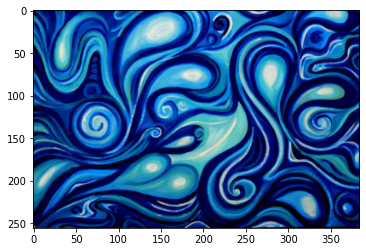

In [2]:
# style_img = image_loader("./image_style/starry_night.jpg", imsize=256, tiling=1, freq_lower = None, freq_upper = None)
# style_img = image_loader("./image_style/patterned_leaves.jpg", imsize=256, tiling=1, freq_lower = None, freq_upper = None)
style_img = image_loader("./image_style/blue_swirls.jpg", imsize = 256, tiling = 1, freq_lower = None, freq_upper = None)

print(style_img.shape)
imshow(image_unloader(style_img));show()

## Step 2: load mesh

/usr/local/lib/python3.7/dist-packages/pytorch3d/io/obj_io.py:530: UserWarning: No mtl file provided
  warnings.warn("No mtl file provided")


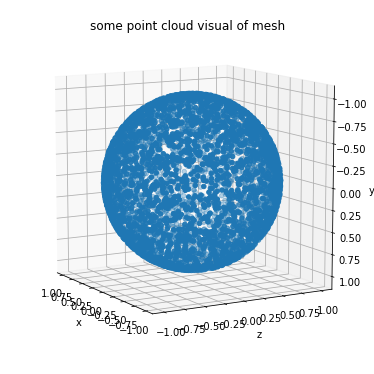

In [3]:
# generate  mesh using PyTorch3D API, or just load it from repository
# src_mesh = ico_sphere(7, device)
# src_mesh = torus(r = 4, R = 4, sides = 350, rings = 400, device = device)
# src_mesh = load_objs_as_meshes(["meshes/igea.obj"], device=device)
# src_mesh = load_objs_as_meshes(["meshes/cube_80samples.obj"], device=device)
src_mesh = load_objs_as_meshes(["meshes/ico_sphere_level7.obj"], device=device)

# have some visualization on point cloud, not necessary
plot_pointcloud(src_mesh, title = "some point cloud visual of mesh")

## Step 3: reshaping

no cameras are given, and sampling_cameras is False
number of cameras: 1


Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

  0%|          | 0/500 [00:00<?, ?it/s]

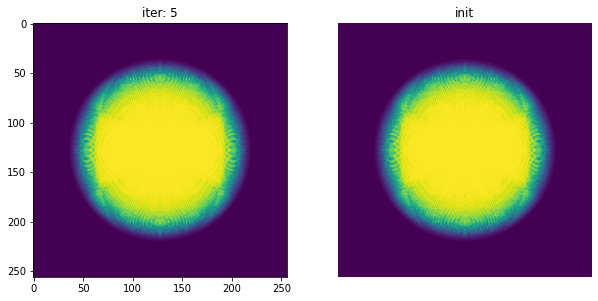

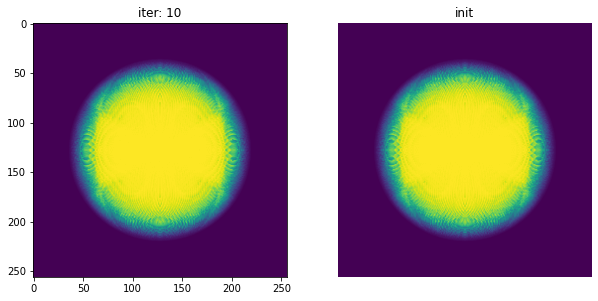

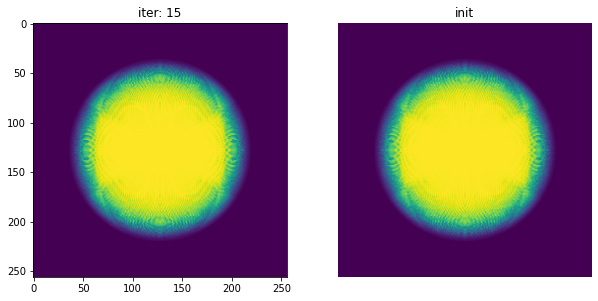

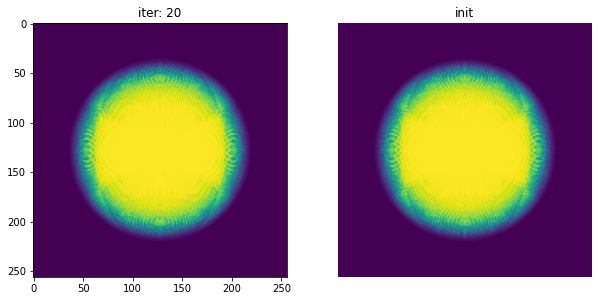

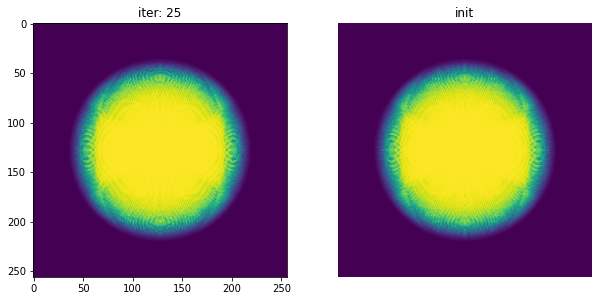

...

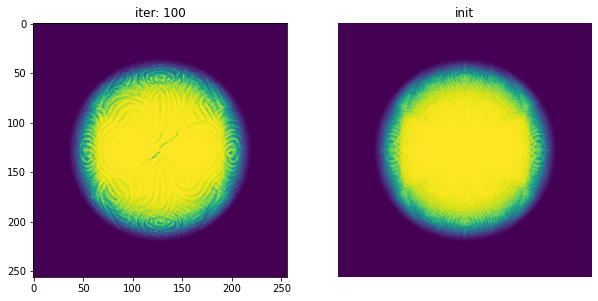

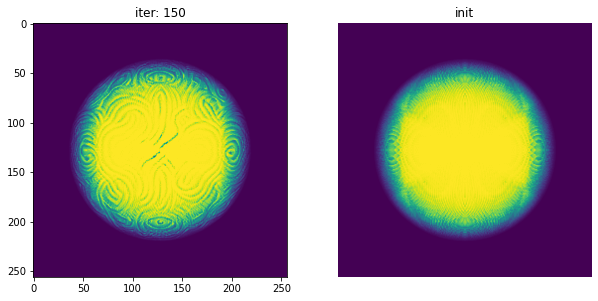

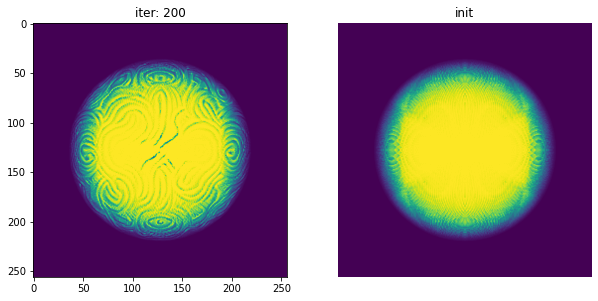

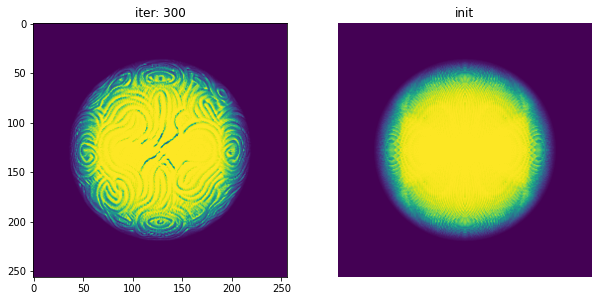

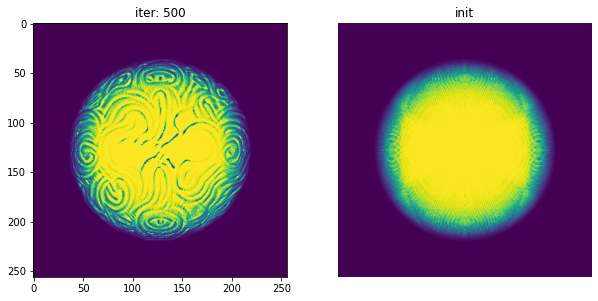

In [4]:
# reload mesh
org_mesh = src_mesh.clone()

# style layers and weights
style_layers = ['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1']
style_weights = [1e6/n**2 for n in [64,128,256,512]]

# image size of rendering
rendering_size = 256

# style loss types and corresponding weights
style_loss_types = {'gram': 1,
                    #'bnst':1,
                    #'morest':1,
                    #'histo':1,
                    #'poly':1,
                    #'linear':1,
                    #'rbf':1e2
                    }

# camera settings
# by default, only using a single fixed camera, thus only small part of mesh is stylized
# you can use more cameras by either setting sampling_cameras to True, or adding more camera positions in elevs and azims
# when using more cameras, increase n_iterations respectively
sampling_cameras = False
elevs = torch.tensor([0])
azims = torch.tensor([0])                  
perspective_camera = True
camera_dist = 2.7
faces_per_pixel = 50
n_views_per_iter = 4

# number of iterations and learning rate
n_iterations = 500
optim_type, learning_rate = 'reshaping', 1e-5

# plot rendering and save mesh at specific iterations
plot_period = [5, 10, 15, 20, 25, 50, 75, 100, 150, 200, 300, 500, 1000, 1500, 2000]

# masking
masking = False
mask_pooling = 'avg'

# max or avg pooling
model_pooling = 'max'

# whether compel color in range [0, 1]
clamping = False

# whether reshaping with colorful renderings
reshaping_rgb = False

# pipeline
verts_offsets, re_cameras, loss_history_reshaping, rendering_at_iter_reshaping = pipeline_3D_NST(org_mesh,
                                                                                    style_img,
                                                                                    optim_type = optim_type,
                                                                                    optim_init = None,
                                                                                    rendering_size = rendering_size,
                                                                                    style_layers = style_layers,
                                                                                    style_weights = style_weights,
                                                                                    n_views_per_iter = n_views_per_iter, 
                                                                                    cameras = None,
                                                                                    sampling_cameras = sampling_cameras,
                                                                                    elevs = elevs,
                                                                                    azims = azims,   
                                                                                    perspective_camera = perspective_camera,
                                                                                    camera_dist = camera_dist,
                                                                                    faces_per_pixel = faces_per_pixel,
                                                                                    n_iterations = n_iterations, 
                                                                                    learning_rate = learning_rate,
                                                                                    plot_period = plot_period,
                                                                                    style_loss_types = style_loss_types,
                                                                                    masking = masking,
                                                                                    model_pooling = model_pooling,
                                                                                    mask_pooling = mask_pooling,
                                                                                    clamping = clamping,
                                                                                    reshaping_rgb = reshaping_rgb
                                                                                    )

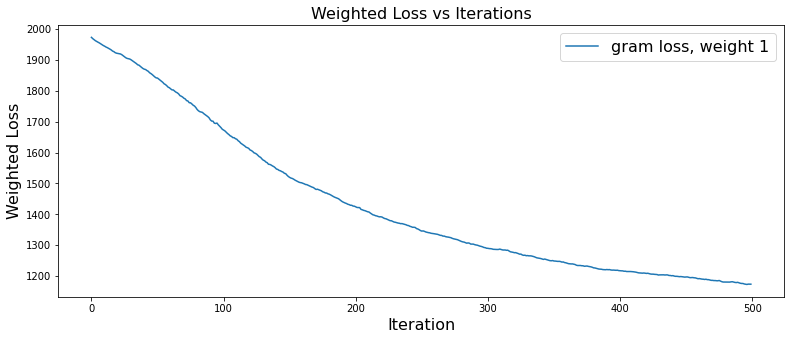

In [5]:
# plot loss
plot_loss(loss_history_reshaping, loss_name = None, start = 0, end = n_iterations)

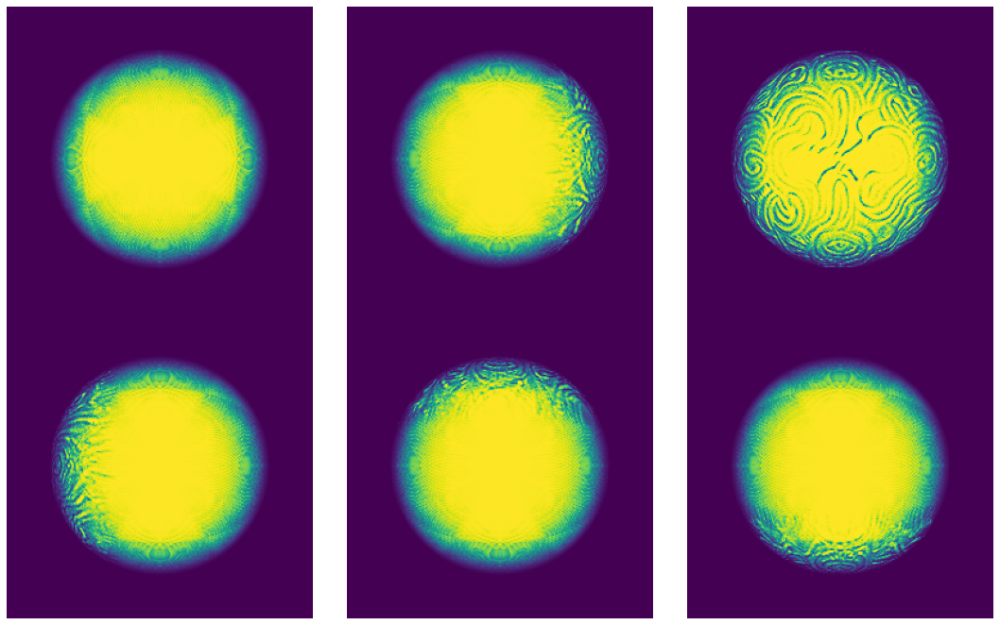

In [6]:
# more views of mesh
plot_mesh = src_mesh.clone()
mesh_normalization(plot_mesh)
plot_mesh.offset_verts_(verts_offsets)
grid_plot(plot_mesh, sil_shader = True, rgb = False, rendering_size = 256)

In [7]:
# 3D visualization
plot_mesh = src_mesh.clone()
mesh_normalization(plot_mesh)
plot_mesh.offset_verts_(verts_offsets)

fig = plot_scene({
    "3D visualization": {
        "mesh": plot_mesh
    }
})
fig.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


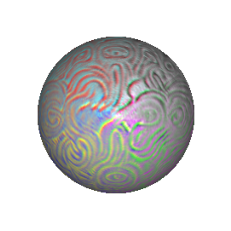

In [8]:
# per-vertex position offset as per-vertex color
verts_offsets_normalized = verts_offsets - verts_offsets.min()
verts_offsets_normalized = verts_offsets_normalized / verts_offsets_normalized.max()
plot_mesh = src_mesh.clone()
plot_mesh.textures = TexturesVertex(verts_features = verts_offsets_normalized.unsqueeze(0))
_ = single_plot(plot_mesh, sil_shader = False, rgb=True)

## Step 4: texturing

cameras are already given, reusing the given cameras
number of cameras: 1


  0%|          | 0/300 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

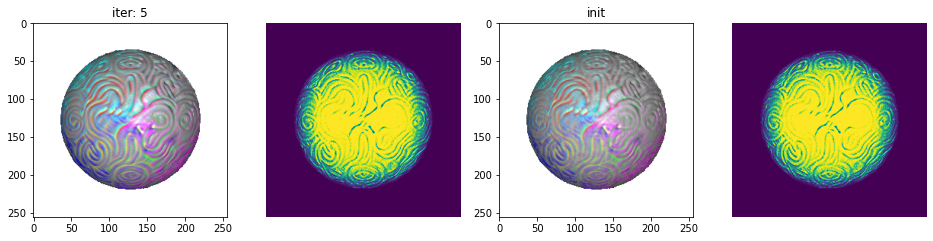

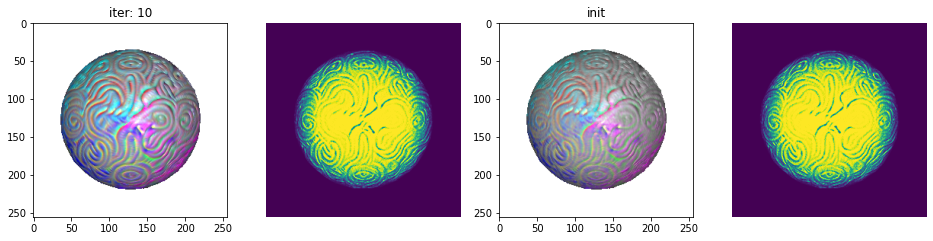

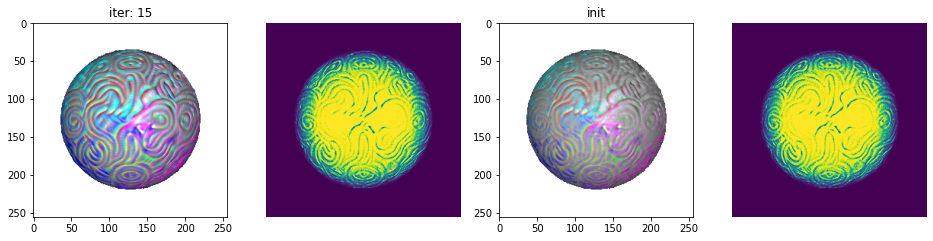

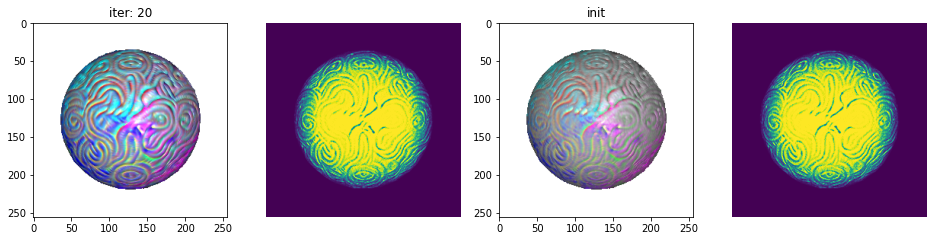

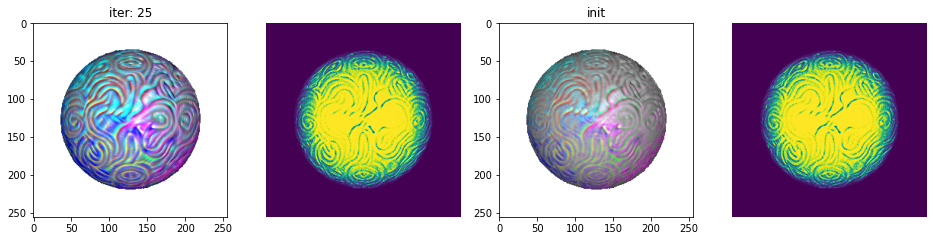

...

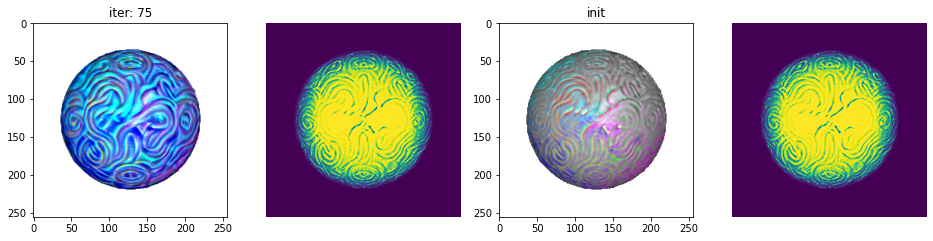

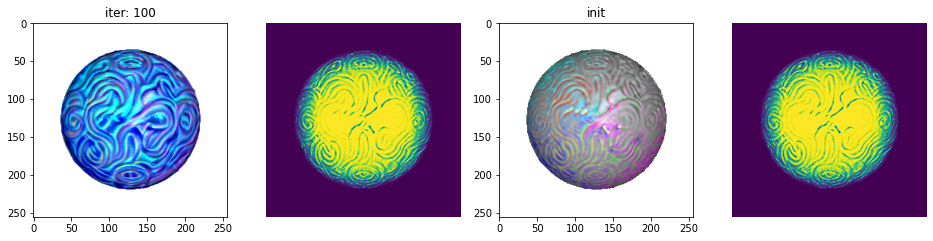

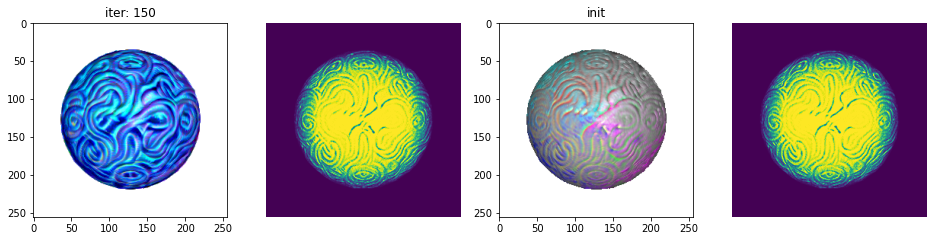

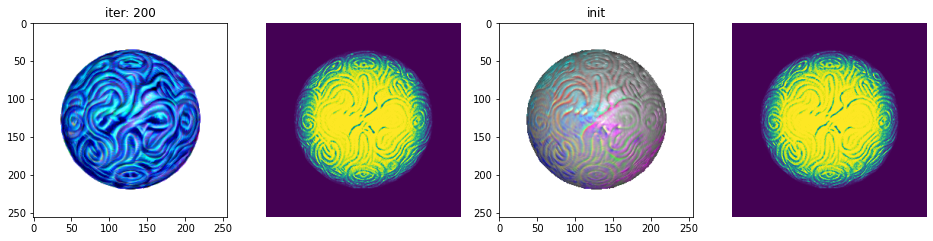

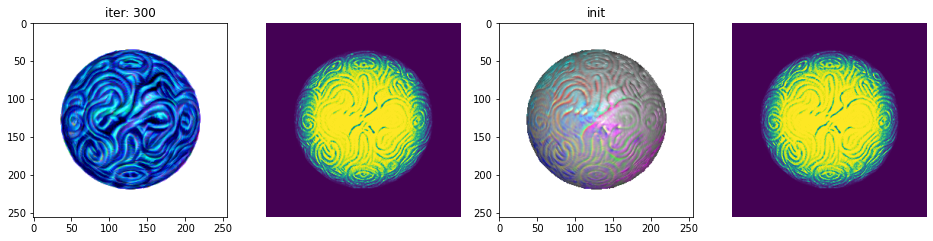

In [9]:
# update mesh vertex offsets
org_mesh = src_mesh.clone()
mesh_normalization(org_mesh)
org_mesh.offset_verts_(verts_offsets.detach())

# style layers and weights
style_layers = ['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1']
style_weights = [1e6/n**2 for n in [64,128,256,512]]

# image size of rendering
rendering_size = 256

# BNST performs better than gram w.r.t. texturing
style_loss_types = {#'gram': 1,
                    'bnst':1,
                    #'morest':1,
                    #'histo':1,
                    #'poly':1,
                    #'linear':1,
                    #'rbf':1e2
                    }

# re-use cameras
cameras = re_cameras

# offsets as color init
optim_init = verts_offsets

# number of iterations and learning rate
n_iterations = 300
optim_type, learning_rate = 'texturing', 1e-2
plot_period = [5, 10, 15, 20, 25, 50, 75, 100, 150, 200, 300, 500, 1000, 1500, 2000]

# masking
masking = False
mask_pooling = 'avg'

# max or avg pooling
model_pooling = 'max'

# whether compel color in range [0, 1]
clamping = False

# whether reshaping with colorful renderings, meaningless in case of texturing
reshaping_rgb = False

# pipeline
verts_color, _, loss_history_texturing, rendering_at_iter_texturing = pipeline_3D_NST( org_mesh,
                                                                              style_img,
                                                                              optim_type = optim_type,
                                                                              optim_init = optim_init,
                                                                              rendering_size = rendering_size,
                                                                              style_layers = style_layers,
                                                                              style_weights = style_weights,
                                                                              n_views_per_iter = n_views_per_iter, 
                                                                              cameras = cameras,
                                                                              sampling_cameras = sampling_cameras,
                                                                              elevs = elevs,
                                                                              azims = azims,   
                                                                              perspective_camera = perspective_camera,
                                                                              camera_dist = camera_dist,
                                                                              faces_per_pixel = faces_per_pixel,
                                                                              n_iterations = n_iterations, 
                                                                              learning_rate = learning_rate,
                                                                              plot_period = plot_period,
                                                                              style_loss_types = style_loss_types,
                                                                              masking = masking,
                                                                              model_pooling = model_pooling,
                                                                              mask_pooling = mask_pooling,
                                                                              clamping = clamping,
                                                                              reshaping_rgb = reshaping_rgb
                                                                              )

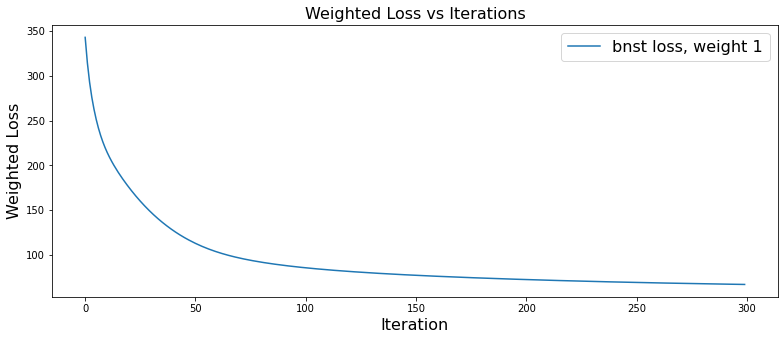

In [12]:
# plot loss
plot_loss(loss_history_texturing, loss_name = None, start = 0, end = n_iterations)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


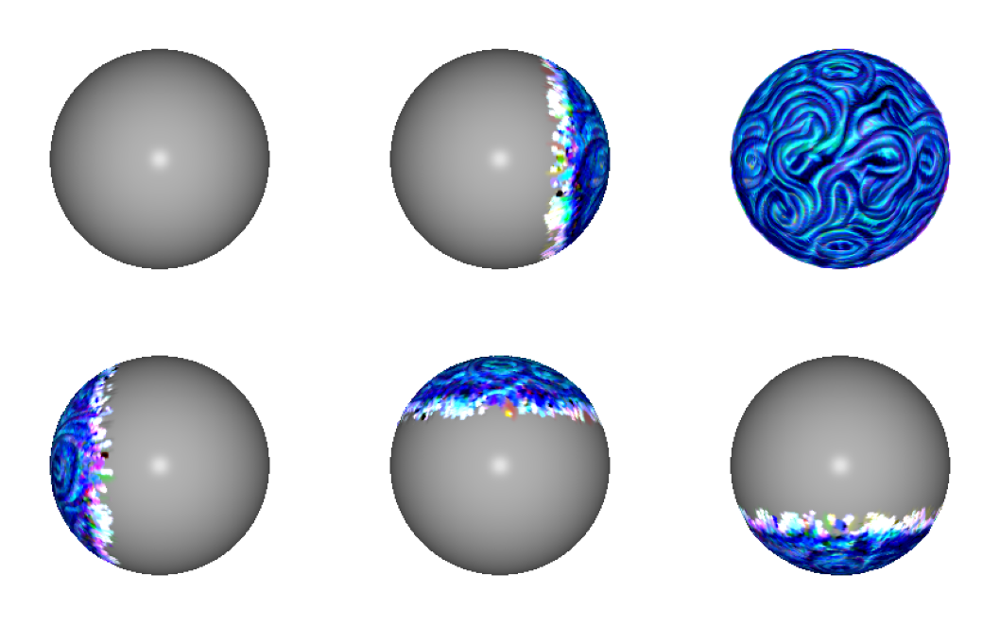

In [13]:
# more views of mesh
plot_mesh = src_mesh.clone()
mesh_normalization(plot_mesh)
plot_mesh.offset_verts_(verts_offsets)
plot_mesh.textures = TexturesVertex(verts_features = verts_color.detach())
grid_plot(plot_mesh, sil_shader = False, rgb = True, rendering_size = 256)

In [14]:
# 3D visualization
plot_mesh = src_mesh.clone()
mesh_normalization(plot_mesh)
plot_mesh.offset_verts_(verts_offsets)
plot_mesh.textures = TexturesVertex(verts_features = verts_color.detach())

fig = plot_scene({
    "3D visualization": {
        "mesh": plot_mesh
    }
})
fig.show()

## Step 4+: what if initializing color with random noise?

cameras are already given, reusing the given cameras
number of cameras: 1


  0%|          | 0/300 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

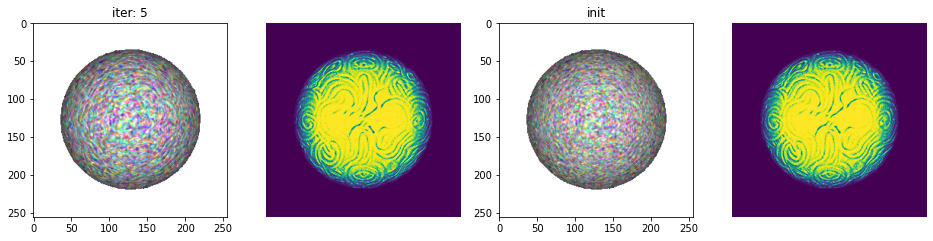

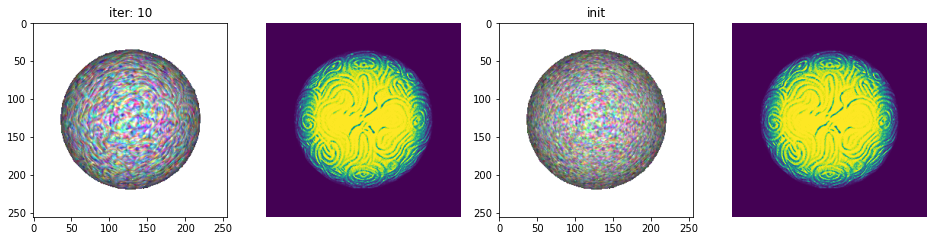

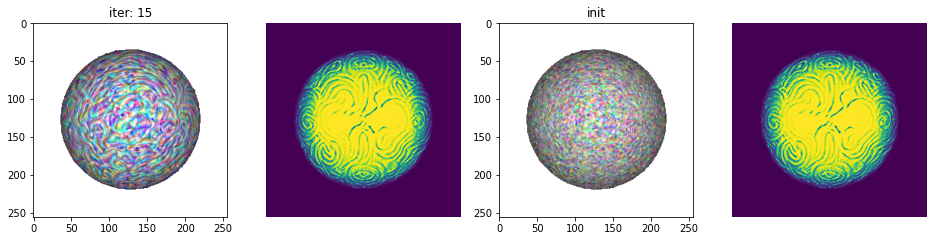

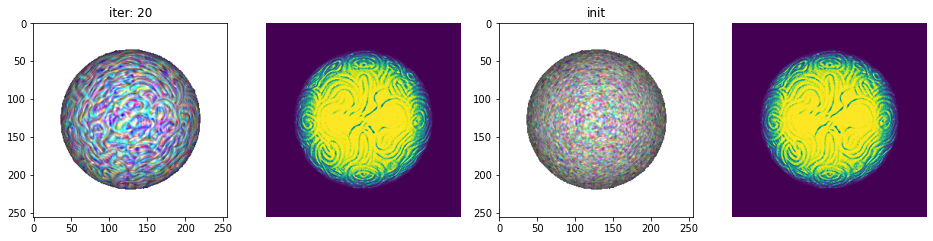

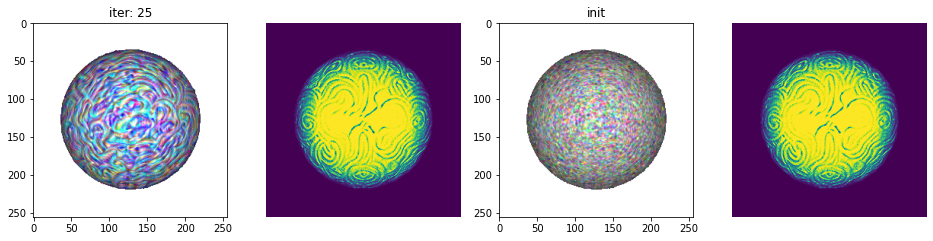

...

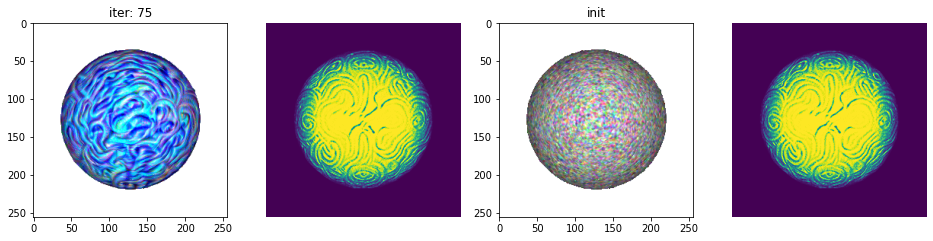

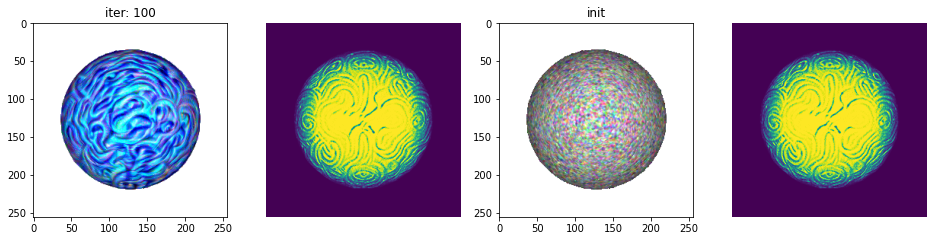

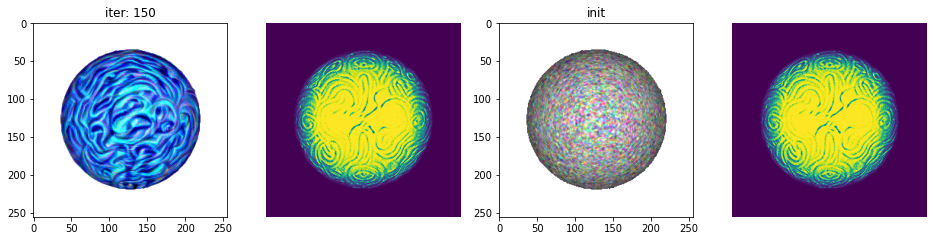

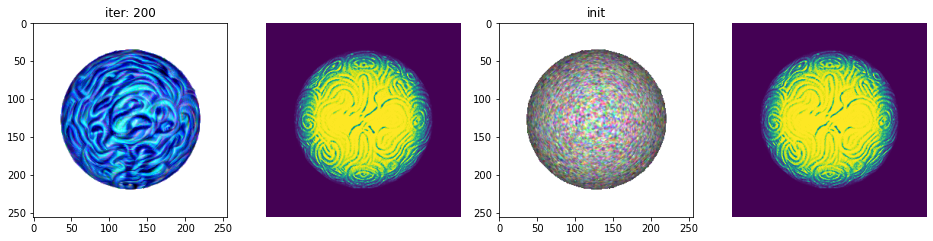

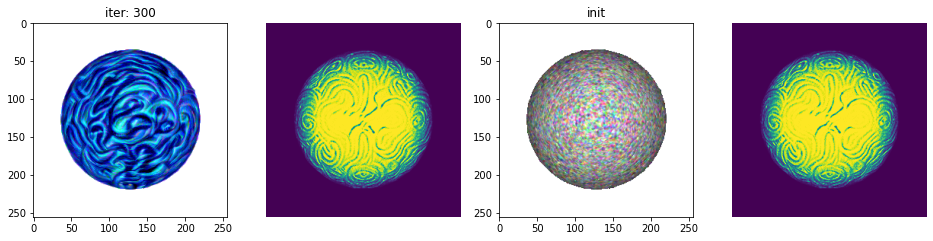

In [15]:
# update mesh vertex offsets
org_mesh = src_mesh.clone()
org_mesh.offset_verts_(verts_offsets.detach())

# style layers and weights
style_layers = ['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1']
style_weights = [1e6/n**2 for n in [64,128,256,512]]

# image size of rendering
rendering_size = 256

# BNST performs better than gram w.r.t. texturing
style_loss_types = {#'gram': 1,
                    'bnst':1,
                    #'morest':1,
                    #'histo':1,
                    #'poly':1,
                    #'linear':1,
                    #'rbf':1e2
                    }

# re-use cameras
cameras = re_cameras

# random noise as color init
optim_init = torch.rand(verts_offsets.shape, device = device)

# number of iterations and learning rate
n_iterations = 300
optim_type, learning_rate = 'texturing', 1e-2
plot_period = [5, 10, 15, 20, 25, 50, 75, 100, 150, 200, 300, 500, 1000, 1500, 2000]

# masking
masking = False
mask_pooling = 'avg'

# max or avg pooling
model_pooling = 'max'

# whether compel color in range [0, 1]
clamping = False

# whether reshaping with colorful renderings, meaningless in case of texturing
reshaping_rgb = False

# pipeline
verts_color, _, loss_history_texturing, rendering_at_iter_texturing = pipeline_3D_NST( org_mesh,
                                                                              style_img,
                                                                              optim_type = optim_type,
                                                                              optim_init = optim_init,
                                                                              rendering_size = rendering_size,
                                                                              style_layers = style_layers,
                                                                              style_weights = style_weights,
                                                                              n_views_per_iter = n_views_per_iter, 
                                                                              cameras = cameras,
                                                                              sampling_cameras = sampling_cameras,
                                                                              elevs = elevs,
                                                                              azims = azims,   
                                                                              perspective_camera = perspective_camera,
                                                                              camera_dist = camera_dist,
                                                                              faces_per_pixel = faces_per_pixel,
                                                                              n_iterations = n_iterations, 
                                                                              learning_rate = learning_rate,
                                                                              plot_period = plot_period,
                                                                              style_loss_types = style_loss_types,
                                                                              masking = masking,
                                                                              model_pooling = model_pooling,
                                                                              mask_pooling = mask_pooling,
                                                                              clamping = clamping,
                                                                              reshaping_rgb = reshaping_rgb,
                                                                              )